<a href="https://colab.research.google.com/github/CMACOBRADOR/License-Plate-Detection-using-Yolov5-and-EasyOCR/blob/main/image%20output.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Before starting typing codes, click "Edit", select notebook settings and in Hardware Accelerator, select "GPU"

For training part

**1. Importing Images and yml file from Google Drive**

In [ ]:
 from google.colab import drive
 drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
!unzip /content/gdrive/MyDrive/LicensePlateDetection/train.zip -d /content/files1

Archive:  /content/gdrive/MyDrive/LicensePlateDetection/train.zip
   creating: /content/files1/train/images/
  inflating: /content/files1/train/images/1.jpg  
  inflating: /content/files1/train/images/10.jpg  
  inflating: /content/files1/train/images/100.jpg  
  inflating: /content/files1/train/images/101.jpg  
  inflating: /content/files1/train/images/102.jpg  
  inflating: /content/files1/train/images/103.jpg  
  inflating: /content/files1/train/images/104.jpg  
  inflating: /content/files1/train/images/105.jpg  
  inflating: /content/files1/train/images/106.jpg  
  inflating: /content/files1/train/images/107.jpg  
  inflating: /content/files1/train/images/108.jpg  
  inflating: /content/files1/train/images/11.jpg  
  inflating: /content/files1/train/images/110.jpg  
  inflating: /content/files1/train/images/112.jpg  
  inflating: /content/files1/train/images/113.jpg  
  inflating: /content/files1/train/images/114.jpg  
  inflating: /content/files1/train/images/115.jpg  
  inflating

**2. Install needed libraries**

In [ ]:
!pip install torch==1.8.2+cu111 torchvision==0.9.2+cu111 torchaudio===0.8.2 -f https://download.pytorch.org/whl/lts/1.8/torch_lts.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/lts/1.8/torch_lts.html
     |█████████████▌                  | 834.1 MB 1.3 MB/s eta 0:15:18tcmalloc: large alloc 1147494400 bytes == 0x649a2000 @  0x7f27a13a7615 0x592b76 0x4df71e 0x59afff 0x515655 0x549576 0x593fce 0x548ae9 0x51566f 0x549576 0x593fce 0x548ae9 0x5127f1 0x598e3b 0x511f68 0x598e3b 0x511f68 0x598e3b 0x511f68 0x4bc98a 0x532e76 0x594b72 0x515600 0x549576 0x593fce 0x548ae9 0x5127f1 0x549576 0x593fce 0x5118f8 0x593dd7
     |█████████████████               | 1055.7 MB 1.2 MB/s eta 0:12:43tcmalloc: large alloc 1434370048 bytes == 0x21ca000 @  0x7f27a13a7615 0x592b76 0x4df71e 0x59afff 0x515655 0x549576 0x593fce 0x548ae9 0x51566f 0x549576 0x593fce 0x548ae9 0x5127f1 0x598e3b 0x511f68 0x598e3b 0x511f68 0x598e3b 0x511f68 0x4bc98a 0x532e76 0x594b72 0x515600 0x549576 0x593fce 0x548ae9 0x5127f1 0x549576 0x593fce 0x5118f8 0x593dd7
     |█

In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 12229, done.
remote: Counting objects: 100% (46/46), done.
remote: Compressing objects: 100% (32/32), done.
remote: Total 12229 (delta 23), reused 28 (delta 14), pack-reused 12183
Receiving objects: 100% (12229/12229), 11.97 MiB | 31.75 MiB/s, done.
Resolving deltas: 100% (8459/8459), done.


In [ ]:
!pip install -r /content/yolov5/requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 596 kB 5.1 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
!git clone https://github.com/deepakat002/numberplaterecognition.git ##for detecting text in images

Cloning into 'numberplaterecognition'...
remote: Enumerating objects: 24, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (22/22), done.
remote: Total 24 (delta 5), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (24/24), done.


In [ ]:
!pip install -r /content/numberplaterecognition/requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 149 kB 5.1 MB/s 
     |████████████████████████████████| 70.8 MB 13 kB/s 
     |████████████████████████████████| 930 kB 60.3 MB/s 
     |████████████████████████████████| 156 kB 74.6 MB/s 
     |████████████████████████████████| 4.4 MB 56.3 MB/s 
     |████████████████████████████████| 61 kB 7.0 MB/s 
     |████████████████████████████████| 3.4 MB 24.3 MB/s 
     |████████████████████████████████| 11.2 MB 50.4 MB/s 
ERROR: Could not find a version that satisfies the requirement networkx==2.8 (from versions: 0.34, 0.35, 0.35.1, 0.36, 0.37, 0.99, 1.0rc1, 1.0, 1.0.1, 1.1, 1.2rc1, 1.2, 1.3rc1, 1.3, 1.4rc1, 1.4, 1.5rc1, 1.5, 1.6rc1, 1.6, 1.7rc1, 1.7, 1.8rc1, 1.8, 1.8.1, 1.9rc1, 1.9, 1.9.1, 1.10rc2, 1.10, 1.11rc1, 1.11rc2, 1.11, 2.0, 2.1, 2.2rc1, 2.2, 2.3rc3, 2.3rc4, 2.3, 2.4rc1, 2.4rc2, 2.4, 2.5rc1, 2.5, 2.5.1, 2.6rc1, 2.6rc2, 2.6, 2.6.1, 2.6.2, 2.6.3)


In [ ]:
!pip install easyocr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 70.8 MB 17 kB/s 
     |████████████████████████████████| 47.6 MB 1.3 MB/s 


In [ ]:
!pip  install opencv-python==4.5.4.60

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 60.3 MB 1.3 MB/s 
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


**3. Importing libraries**

In [ ]:
import torch
from matplotlib import pyplot as plt
import numpy as np
from google.colab.patches import cv2_imshow
import easyocr
import cv2
import re
import time

**4. Downloading a Pre-trained model**

In [ ]:
!model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

/bin/bash: -c: line 0: syntax error near unexpected token `('
/bin/bash: -c: line 0: `model = torch.hub.load('ultralytics/yolov5', 'yolov5s')'


**5. Training the model**

Before training, move the yml file to yolov5 folder

In [ ]:
!cd yolov5 && python train.py --img 320 --batch 16 --epochs 500 --data dataset.yml --weights yolov5s.pt --workers 2

train: weights=yolov5s.pt, cfg=, data=dataset.yml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=16, imgsz=320, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=2, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-251-gc23a441 Python-3.7.13 torch-1.8.2+cu111 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=

In [ ]:
!unzip /content/gdrive/MyDrive/LicensePlateDetection/fortesting.zip -d /content/files2

Archive:  /content/gdrive/MyDrive/LicensePlateDetection/fortesting.zip
  inflating: /content/files2/for testing/10.jpg  
  inflating: /content/files2/for testing/11.jpg  
  inflating: /content/files2/for testing/2.jpg  
  inflating: /content/files2/for testing/251.jpg  
  inflating: /content/files2/for testing/255.jpg  
  inflating: /content/files2/for testing/257.jpg  
  inflating: /content/files2/for testing/258.jpg  
  inflating: /content/files2/for testing/260.jpg  
  inflating: /content/files2/for testing/261.jpg  
  inflating: /content/files2/for testing/262.jpg  
  inflating: /content/files2/for testing/279.jpg  
  inflating: /content/files2/for testing/280.jpg  
  inflating: /content/files2/for testing/281.jpg  
  inflating: /content/files2/for testing/282.jpg  
  inflating: /content/files2/for testing/283.jpg  
  inflating: /content/files2/for testing/284.jpg  
  inflating: /content/files2/for testing/285.jpg  
  inflating: /content/files2/for testing/286.jpg  
  inflating: /c

For recognizing part

In [ ]:
EASY_OCR = easyocr.Reader(['en']) ### initiating easyocr
OCR_TH = 0.2
model = torch.hub.load('ultralytics/yolov5','custom', path='/content/yolov5/yolov5s.pt', force_reload=True)
classes= '/content/files1/train/labels/classes.txt'
#Input
img_path='/content/files2/pictures/10.jpg'
#vid_path=

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip
requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

requirements: torch>=1.7.0 not found and is required by YOLOv5, attempting auto-update...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

requirements: torchvision>=0.8.1 not found and is required by YOLOv5, attempting auto-update...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

requirements: 3 packages updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 2022-6-12 Python-3.7.13 torch-1.8.2+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 722588

In [ ]:
#funtion to run detection
def detectx (frame, model):
    frame = [frame]
    print(f"[INFO] Detecting. . . ")
    results = model(frame)
  
    labels, coordinates = results.xyxyn[0][:, -1], results.xyxyn[0][:, :-1]

    return labels, coordinates

In [ ]:
#plotting the BBox and preparation fo rresults
def plot_boxes(results, frame,classes):

  
    labels, cord = results
    n = len(labels)
    x_shape, y_shape = frame.shape[1], frame.shape[0]
    print(f"[INFO] Total plates detected= {n}")
    print(f"[INFO] Looping through all detections. . . ")


    ### looping through the detections
    for i in range(n):
        row = cord[i]
        if row[4] >= 0.55: ### threshold value for detection. We are discarding everything below this value
            print(f"[INFO] Extracting BBox coordinates. . . ")
            x1, y1, x2, y2 = int(row[0]*x_shape), int(row[1]*y_shape), int(row[2]*x_shape), int(row[3]*y_shape) ## BBOx coordniates
            text_d = classes[int(labels[i])]
            

            coords = [x1,y1,x2,y2]

            plate_num = recognize_plate_easyocr(img = frame, coords= coords, reader= EASY_OCR, region_threshold= OCR_TH)


          
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2) ## BBox 
            cv2.rectangle(frame, (x1, y1), (x2, y1), (0, 255,0), -1) ## for text label background 
            cv2.putText(frame, f"{plate_num}", (x1, y1), cv2.FONT_HERSHEY_SIMPLEX, 0.5,(255,255,255), 2)
            
            




    return frame

In [ ]:
#for OCR detection
def recognize_plate_easyocr(img, coords,reader,region_threshold):
    # separate coordinates from box
    xmin, ymin, xmax, ymax = coords
    # get the subimage that makes up the bounded region and take an additional 5 pixels on each side
    # nplate = img[int(ymin)-5:int(ymax)+5, int(xmin)-5:int(xmax)+5]
    nplate = img[int(ymin):int(ymax), int(xmin):int(xmax)] ### cropping the number plate from the whole image


    ocr_result = reader.readtext(nplate, paragraph='True')



    text = filter_text(region=nplate, ocr_result=ocr_result, region_threshold= region_threshold)

    if len(text) ==1:
        text = text[0].upper()
    return text


### to filter out wrong detections 

def filter_text(region, ocr_result, region_threshold):
    rectangle_size = region.shape[0]*region.shape[1]
    
    plate = [] 
    print(ocr_result)
    for result in ocr_result:
        length = np.sum(np.subtract(result[0][1], result[0][0]))
        height = np.sum(np.subtract(result[0][2], result[0][1]))
        
        if length*height / rectangle_size > region_threshold:
            plate.append(result[1])
    return plate


[INFO] Detecting. . . 
[INFO] Total plates detected= 1
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 
[[[[63, 50], [761, 50], [761, 235], [63, 235]], 'NGR 5314']]


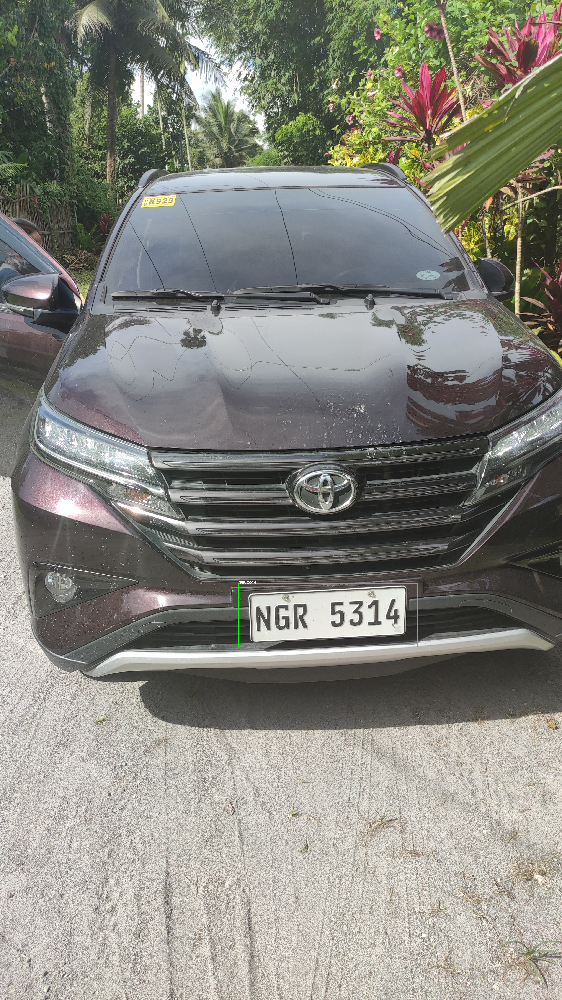

True

In [ ]:
#image detection
frame = cv2.imread(img_path) 
frame = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)   
results = detectx(frame, model = model)  
frame = cv2.cvtColor(frame,cv2.COLOR_RGB2BGR)
frame = plot_boxes(results, frame, classes=classes)
cv2_imshow(frame)
cv2.imwrite('10result.jpg', frame)
  